In [1]:
# Run this cell!
from datascience import *
import pandas as pd
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import *
import geopandas as gpd
import folium
from plotly import graph_objects as go
from plotly.subplots import make_subplots
import re
from scipy import stats

# Aspiranet Project Notebook

## Introduction
In order to maintain compliance, Aspiranet is required by state law to identify disparities (defined broadly) within their services. Initially, they are interested in the following:
* Whether certain groups have more incidents than others
* Whether certain groups are more likely to have certain kinds of incidents
* Whether any incidents predict occurences of other incidents
* Whether certain kinds of incidents are more likely to occur at certain times of year
* Whether certain kinds of incidents occur most often at a particular day of service

## Exploratory Data Analysis

### Data
So far, two datasets have been provided. The first, `demographics`, contains information on the individual clients served by Aspiranet and some demographic features (i.e. sex, age, race, etc.); and the second, `incidents` contains information on individual incidents. Both are loaded in below. More details on the specifics of each dataframe are included below.

In [2]:
# Data cleaning functions
ca_counties = ['alameda', 'alpine', 'amador', 'butte', 'calaveras',
               'colusa', 'contra costa', 'del norte', 'el dorado', 'fresno',
               'glenn', 'humboldt', 'imperial', 'inyo', 'kern', 
               'kings', 'lake', 'lassen', 'los angeles', 'madera',
               'marin', 'mariposa', 'mendocino', 'merced', 'modoc',
               'mono', 'monterey', 'napa', 'nevada', 'orange',
               'placer', 'plumas', 'riverside', 'sacramento', 'san benito',
               'san bernardino', 'san diego', 'san francisco', 'san joaquin', 'san luis obispo',
               'san mateo', 'santa barbara', 'santa clara', 'santa cruz', 'shasta',
               'sierra', 'siskiyou', 'solano', 'sonoma', 'stanislaus', 
               'sutter', 'tehama', 'trinity', 'tulare', 'tuolumne', 
               'ventura', 'yolo', 'yuba']

def clean_county_col(df, county_col):
    '''
    Given DataFrame df of shape (r, c) and string county_col, returns a Series
    counties of shape (r, 1) with extracted county names
    -----
    Input:
    
    df (DataFrame) - DataFrame with CountyOfService column to clean
    
    county_col (string) - Name of column in df with county names
    -----
    Output:
    
    counties (Series) - Series with extracted county names
    '''
    df = df.copy()
    df[county_col] = df[county_col].str.lower()
    
    # replace abbreviations
    df[county_col] = df[county_col].str.replace(r'stan', 'stanislaus', regex=True)
    df[county_col] = df[county_col].str.replace(r'l.a.', 'los angeles', regex=True)
    df[county_col] = df[county_col].str.replace(r'san fran', 'san francisco', regex=True)
    
    # map district to county
    district_to_county_dict = { 
        '|'.join(['oxnard','simi valley','moorpark','conejo valley', 'briggs',
        'santa paula','ojai','hueneme','fillmore','oak park']) : 'ventura',
        '|'.join(['las virgenes','palmdale']) : 'los angeles',
        'ocean view' : 'orange',
        'kaiser': 'sacramento',
        'berkeley' : 'alameda',
        'csma' : 'santa clara', #looks like it serves both santa clara and san mateo?
        '|'.join(['strtp','excell center']) : 'stanislaus' #UNSURE
        # what is 'pcit'?
    }
    df.replace(to_replace=district_to_county_dict, inplace=True, regex=True)
    
    p = '({})'.format('|'.join(ca_counties))
    df['cleaned_county'] = df[county_col].str.extract(p, expand=False).fillna('unknown')
    counties = df['cleaned_county']
    #only return col, not df because other cols have been mutated
    return counties

def convert_to_datetime(string, format='%m/%d/%Y'):
    '''
    Function that takes a string in format MM/DD/YYYY and converts it to
    a Python datetime object
    -----
    Input:
    
    string (str) - String object to convert
    -----
    Output:
    
    time_obj (datetime) - datetime object
    '''
    time_obj = datetime.strptime(string, format)
    return time_obj

In [3]:
# Read in data
demographics = pd.read_csv('Data/Demographics.csv')
incidents = pd.read_csv('Data/Incidents.csv')

# Clean county names
demographics['County'] = clean_county_col(demographics, 'CountyofService')
demographics['County Upper'] = [' '.join([word.capitalize() for word in re.split('\s', county_name)])
                                for county_name in demographics['County']]
demographics = demographics.drop('County', axis=1) \
                           .rename(columns={'County Upper': 'County'})
incidents['County'] = clean_county_col(incidents, 'CountyOService')
incidents['County Upper'] = [' '.join([word.capitalize() for word in re.split('\s', county_name)])
                             for county_name in incidents['County']]
incidents = incidents.drop('County', axis=1) \
                     .rename(columns={'County Upper': 'County'})

# Clean IncidentDate
incidents['IncidentDatetime'] = [convert_to_datetime(object) for object in incidents['IncidentDate'].values]
incidents['Month'] = [date.month for date in incidents['IncidentDatetime']]
incidents['Year'] = [date.year for date in incidents['IncidentDatetime']]

# Reorder incidents dataframe
incidents = incidents[['IncidentDatetime', 'IncidentDate', 'Month', 'Year',
                       'IncidentTypeCode', 'IncidentType', 'SubTypeCode',
                       'IncidentSubType', 'OptionsNumber', 'AgeAtIncident',
                       'Gender', 'Ethnicity', 'PrimaryLanguage',
                       'Religion', 'ServiceDivision','County']]

#### `Demographics`
The `demographics` dataframe contains data on individual members/clients who Aspiranet provides services to. Members/clients may appear more than once within `demographics` (with unique identifier `OptionsNumber`) if they left Aspiranet services but later returned. The `demographics` data also contains features for gender, age (at start of service), ethnicity, primary language, religion, and service division. A description of each feature is included below:
* `OptionsNumber` - the ID number for each unique Aspiranet client (**unique identifier/primary key**)
* `Gender` - perceived biological sex (takes on values 'U', 'F', 'M', or '' where 'U' is unknown and '' signifies the question was not asked)
* `AgeAtStart` - discrete variable indicating the age of the client at the start of a service period
* `Ethnicity` - perceived race/ethnicity of the client as determined by the social worker (changes may indicate bi/multiraciality, a different social worker, etc.)
* `PrimaryLanguage` - first language of the client
* `Religion` - primary religion of the client ('[Not Entered]' values indicate the question was not asked by the social worker)
* `ServiceDivision` - division of services under which the client is housed
* `CountyofService` - facility where client is being offered services (includes county name)
* `County` - County where invidiual is receiving services (used as a proxy for client location); stripped from `CountyofService`

#### `Incidents`

The `incidents` dataframe contains data on incident reports for the years 2019 - 2022. It includes features such as incident date (date incident was reported), the incident type code, the subsequent incident name, incident subtype code, incident subtype, `OptionsNumber` (unique identifier), age at incident, gender (biological sex), race/ethnicity, primary language, religion, and their home division. A brief description is included below:
* `IncidentDate` - date of incident report (str in MM/DD/YYYY format)
* `IncidentTypeCode` - code mapping to a particular incident type
* `IncidentType` - name of the incident type
* `SubTypeCode` - code mapping to a particular *subincident* type
* `IncidentSubType` - name of the incident subtype
* `OptionsNumber` - ID number for each unique Aspiranet client (**unique identifer/primary key**) 
* `AgeAtIncident` - age at the time incident report was filed
* `Gender` - perceived biological sex by social worker (see note in `demographics`)
* `Ethnicity` - perceived race/ethnicity of the client as determined by the social worker (changes may indicate bi/multiraciality, a different social worker, etc.)
* `PrimaryLanguage` - first language of the client
* `Religion` - primary religion of the client ('[Not Entered]' values indicate the question was not asked by the social worker)
* `ServiceDivision` - division of services under which the client is housed
* `County` - county location where incident report was filed

## County-Level Dashboard

In [4]:
# Counties present in data
counties_present_lower = demographics[['County']].query('County != "Unknown"')['County'].unique()
counties_present = [' '.join([word.capitalize() for word in re.split('\s', county_name)])
                    for county_name in counties_present_lower]

# Create county_seats dataframe
county_seats_dict = {'County': ['Alameda', 'Alpine', 'Amador',
                                'Butte', 'Calaveras', 'Colusa',
                                'Contra Costa', 'Del Norte', 'El Dorado',
                                'Fresno', 'Glenn', 'Humboldt',
                                'Imperial', 'Inyo', 'Kern',
                                'Kings', 'Lake', 'Lassen',
                                'Los Angeles', 'Madera', 'Marin',
                                'Mariposa', 'Mendocino', 'Merced',
                                'Modoc', 'Mono', 'Monterey',
                                'Napa', 'Nevada', 'Orange',
                                'Placer', 'Plumas', 'Riverside',
                                'Sacramento', 'San Benito', 'San Bernardino',
                                'San Diego', 'San Francisco', 'San Joaquin',
                                'San Luis Obispo', 'San Mateo', 'Santa Barbara',
                                'Santa Clara', 'Santa Cruz', 'Shasta',
                                'Sierra', 'Siskiyou', 'Solano',
                                'Sonoma', 'Stanislaus', 'Sutter',
                                'Tehama', 'Trinity', 'Tulare',
                                'Tuolomne', 'Ventura', 'Yolo',
                                'Yuba'],
                     'County Seats': ['Oakland', 'Markleeville', 'Jackson',
                                      'Oroville', 'San Andreas', 'Colusa',
                                      'Martinez', 'Crescent City', 'Placerville',
                                      'Fresno', 'Willows', 'Eureka',
                                      'El Centro', 'Independence', 'Bakersfield',
                                      'Hanford', 'Lakeport', 'Susanville',
                                      'Los Angeles', 'Madera', 'San Rafael',
                                      'Mariposa', 'Ukiah', 'Merced',
                                      'Alturas', 'Bridgeport', 'Salinas',
                                      'Napa', 'Nevada City', 'Santa Ana',
                                      'Auburn', 'Quincy', 'Riverside',
                                      'Sacramento', 'Hollister', 'San Bernardino',
                                      'San Diego', 'San Francisco', 'Stockton',
                                      'San Luis Obispo', 'Redwood City', 'Santa Barbara',
                                      'San Jose', 'Santa Cruz', 'Redding',
                                      'Downieville', 'Yreka', 'Fairfield',
                                      'Santa Rosa', 'Modesto', 'Yuba City',
                                      'Red Bluff', 'Weaverville', 'Visalia',
                                      'Sonora', 'Ventura', 'Woodland',
                                      'Marysville'],
                     'Latitude': [37.8044, 38.6937, 38.23488,
                                  39.5138, 38.1960, 39.2143,
                                  38.0194, 41.7558, 38.7296,
                                  36.7378, 39.5243, 40.8021,
                                  32.7920, 36.8027, 35.3733,
                                  36.3275, 39.0430, 40.4163,
                                  34.0522, 36.9613, 37.9735,
                                  37.4849, 39.1502, 37.3022,
                                  41.4871, 38.2557, 36.6777,
                                  38.2975, 39.2616, 33.7455,
                                  38.8966, 39.9368, 33.9806,
                                  38.5816, 36.8525, 34.1083,
                                  32.7157, 37.7749, 37.9577,
                                  35.2828, 37.4848, 34.4208,
                                  37.3387, 36.9741, 40.5865,
                                  39.5595, 41.7354, 38.2492,
                                  38.4404, 37.6393, 39.1404,
                                  40.1785, 40.7310, 36.3302,
                                  37.9829, 34.2805, 38.6785,
                                  39.1457],
                     'Longitude': [-122.2712, -119.7797, -120.7741,
                                   -121.5564, -120.6805, -122.0094,
                                   -122.1341, -124.2026, -120.7985,
                                   -119.7871, -122.1936, -124.1637,
                                   -115.5631, -118.2001, -119.0187,
                                   -119.6457, -122.9158, -120.6530,
                                   -118.2437, -120.0607, -122.5311,
                                   -119.9663, -123.2078, -120.4830,
                                   -120.5425, -119.2314, -121.6555,
                                   -122.2869, -121.0161, -117.8677,
                                   -121.0769, -120.9472, -117.3755,
                                   -121.4944, -121.4016, -117.2898,
                                   -117.1611, -122.4194, -121.2908,
                                   -120.6596, -122.2281, -119.6982,
                                   -121.8853, -122.0308, -122.3917,
                                   -120.8277, -122.6345, -122.0405,
                                   -122.7141, -120.9970, -121.6169,
                                   -122.2358, -122.9420, -119.2921,
                                   -120.3822, -119.2945, -121.7733,
                                   -121.5914]}
complete_county_seats = pd.DataFrame(data=county_seats_dict)
complete_county_seats_geo = gpd.GeoDataFrame(complete_county_seats,
                                             geometry=gpd.points_from_xy(complete_county_seats.Latitude, 
                                                                         complete_county_seats.Longitude))
county_seats_geo = complete_county_seats_geo.query('County in @counties_present') \
                                            .reset_index().drop('index', axis=1)

# for looping
figs = {}
county_list = []
html_list = []
upper_county_list = [] # Strictly to be used to create counties_geo dataframe

#counties_present 
for county_name in np.sort(counties_present):
    html_county_name = re.sub('\s', '_', county_name) + '_county'
    title_county_name = ' '.join([word.capitalize() for word in re.split('\s', county_name)])
    upper_county_list.append(title_county_name)
    county_list.append(county_name)
    html_list.append(f'{html_county_name}.html')
    county_incidents = incidents.query('County == @county_name')
    county_incident_count = county_incidents.groupby(['Year', 'Month']).agg({'OptionsNumber': 'count',
                                                                         'AgeAtIncident': 'mean'}) \
                                        .rename(columns={'OptionsNumber': 'Incident Count',
                                                         'AgeAtIncident': 'Average Age'}) \
                                        .reset_index() \
                                        [['Month', 'Year', 'Incident Count', 'Average Age']]

    county_incident_count['Month String'] = [str(item) for item in county_incident_count['Month']]
    county_incident_count['Year String'] = [str(item) for item in county_incident_count['Year']]
    county_incident_count['Unique Month String'] = (county_incident_count['Month String'] + '/' +
                                                    county_incident_count['Year String'])

    county_incident_count['Unique Month'] = [convert_to_datetime(item, '%m/%Y') for item in county_incident_count['Unique Month String']]
    county_incident_count = county_incident_count[['Unique Month', 'Incident Count', 'Average Age']]
    county_incident_count = county_incident_count.rename(columns={'Unique Month': 'Month' })
    county_incident_count['HTML 1'] = [f'<b>{title_county_name} County</b><br><br>Month: ' for i in range(county_incident_count.shape[0])]
    county_incident_count['Text Month'] = [(str(month)[:-19]) for month in county_incident_count['Month'].values]
    county_incident_count['HTML 2'] = ['<br>Average Age: ' for i in range(county_incident_count.shape[0])]
    county_incident_count['Text Age'] = [str(age) for age in county_incident_count['Average Age'].values]
    county_incident_count['HTML 3'] = ['<br>Incident Count: ' for i in range(county_incident_count.shape[0])]
    county_incident_count['Text Count'] = [str(count) for count in county_incident_count['Incident Count'].values]
    county_incident_count['Text'] = (county_incident_count['HTML 1'].values +
                                     county_incident_count['Text Month'].values +
                                     county_incident_count['HTML 2'].values +
                                     county_incident_count['Text Age'].values + 
                                     county_incident_count['HTML 3'].values +
                                     county_incident_count['Text Count'].values)
    county_incident_count = county_incident_count[['Month', 'Incident Count', 'Average Age', 'Text']]

    fig = make_subplots(specs=[[{'secondary_y':True}]])

    fig.add_trace(go.Bar(x=county_incident_count['Month'],
                         y=county_incident_count['Incident Count'],
                         name='Incident Count',
                         hovertext=county_incident_count['Text'],
                         marker_color='#003262'),
                  secondary_y=False)

    fig.add_trace(go.Scatter(x=county_incident_count['Month'],
                             y=county_incident_count['Average Age'],
                             name='Average Age',
                             text=county_incident_count['Text'],
                             hoverinfo='text',
                             line=dict(color='#FDB515',
                                       width=3)),
                  secondary_y=True)

    fig.update_layout(hoverlabel_bgcolor='#B9D3B6',
                      font_family='Georgia',
                      title_text=f'Overview: {title_county_name} County',
                      title_font_size=20,
                      title_x=0.5,
                      hoverlabel=dict(font_family='Georgia'),
                      xaxis=dict(tickfont_size=10,
                                 tickangle=270,
                                 showgrid=True,
                                 zeroline=True,
                                 showline=True,
                                 showticklabels=True,
                                 dtick='M1',
                                 tickformat='%b\n%Y'),
                      legend=dict(orientation='h',
                                  xanchor='center',
                                  x=0.72,
                                  y=1),
                      yaxis_title='Number of Incidents',
                      yaxis2_title='Average Age')

    fig.update_xaxes(rangeslider_visible=True,
                     rangeselector=dict(buttons=list([dict(count=1, label='1m', step='month', stepmode='backward'),
                                                      dict(count=6, label='6m', step='month', stepmode='backward'),
                                                      dict(count=1, label='YTD', step='year', stepmode='todate'),
                                                      dict(count=1, label='1y', step='year', stepmode='backward'),
                                                      dict(step='all')])))
    
    figs[html_county_name] = fig
    fig.write_html(f'Plots/{html_county_name}.html')

county_names_df = pd.DataFrame(data=county_list, columns=['County'])
html_list_df = pd.DataFrame(data=html_list, columns=['HTML File'])
plots_df = pd.concat([county_names_df, html_list_df], axis=1)
display(county_seats_geo.head())
county_seats_geo = pd.merge(left=county_seats_geo, right=plots_df,
                            on='County')
county_seats_geo.head()

,County,County Seats,Latitude,Longitude,geometry
0,Alameda,Oakland,37.8044,-122.2712,POINT (37.804 -122.271)
1,Butte,Oroville,39.5138,-121.5564,POINT (39.514 -121.556)
2,Calaveras,San Andreas,38.1960,-120.6805,POINT (38.196 -120.680)
3,Contra Costa,Martinez,38.0194,-122.1341,POINT (38.019 -122.134)
4,El Dorado,Placerville,38.7296,-120.7985,POINT (38.730 -120.799)


,County,County Seats,Latitude,Longitude,geometry,HTML File
0,Alameda,Oakland,37.8044,-122.2712,POINT (37.804 -122.271),Alameda_county.html
1,Butte,Oroville,39.5138,-121.5564,POINT (39.514 -121.556),Butte_county.html
2,Calaveras,San Andreas,38.1960,-120.6805,POINT (38.196 -120.680),Calaveras_county.html
3,Contra Costa,Martinez,38.0194,-122.1341,POINT (38.019 -122.134),Contra_Costa_county.html
4,El Dorado,Placerville,38.7296,-120.7985,POINT (38.730 -120.799),El_Dorado_county.html


In [5]:
county_borders = gpd.read_file('Data/Counties.zip')
county_borders['County'] = [name for name in county_borders['NAME'].values]
clean_county_borders = county_borders[county_borders['County'].isin(counties_present)] \
                                                              .reset_index() \
                                                              .drop('index', axis=1)

counties_geo = clean_county_borders[['County', 'geometry']]
counties_geo.head()

,County,geometry
0,Sacramento,"POLYGON ((-13490651.476 4680831.603, -13490511..."
1,Santa Barbara,"MULTIPOLYGON (((-13423116.772 4042044.149, -13..."
2,Calaveras,"POLYGON ((-13428575.483 4627725.228, -13428534..."
3,Ventura,"MULTIPOLYGON (((-13317853.594 3931602.414, -13..."
4,Los Angeles,"MULTIPOLYGON (((-13210018.388 3958856.141, -13..."


In [6]:
pd.options.mode.chained_assignment = None
demo_n = demographics.shape[0]
incidents_n = incidents.shape[0]

counties_geo['Proportion of Clients'] = [round(demographics.loc[demographics['County'] == county].shape[0] / demo_n, 4)
                                         if county in demographics['County'].unique() 
                                         else None for county in counties_present]
counties_geo['Proportion of Incidents'] = [round(incidents.loc[incidents['County'] == county].shape[0] / incidents_n, 4)
                                           if county in incidents['County'].unique()
                                           else None for county in counties_present]

first_quartile = np.percentile(counties_geo['Proportion of Incidents'], 25)
second_quartile = np.percentile(counties_geo['Proportion of Incidents'], 50)
third_quartile = np.percentile(counties_geo['Proportion of Incidents'], 75)

counties_geo['Incident Quartile'] = [1 if prop < first_quartile else
                                     2 if prop < second_quartile else
                                     3 if prop < third_quartile
                                     else 4 for prop in counties_geo['Proportion of Incidents']]
counties_geo['Incident Percentile'] = [round(stats.percentileofscore(counties_geo['Proportion of Incidents'],
                                                                     prop),
                                             2)
                                       for prop in counties_geo['Proportion of Incidents'].values]
counties_geo['Largest Division'] = [demographics.loc[demographics['County'] == county] \
                                                .groupby('ServiceDivision').count() \
                                                .sort_values('ServiceDivision', ascending=False) \
                                                .reset_index() \
                                                .iloc[0, 0]
                                    for county in counties_geo['County'].values]
counties_geo['Top Incident Type'] = [incidents.loc[incidents['County'] == county] \
                                              .groupby('IncidentType').count() \
                                              .sort_values('IncidentType', ascending=False) \
                                              .reset_index() \
                                              .iloc[0, 0]
                                     for county in counties_geo['County'].values]
counties_geo.head()

,County,geometry,Proportion of Clients,Proportion of Incidents,Incident Quartile,Incident Percentile,Largest Division,Top Incident Type
0,Sacramento,"POLYGON ((-13490651.476 4680831.603, -13490511...",0.3207,0.1219,4,97.14,Transitional,Unusual Incident
1,Santa Barbara,"MULTIPOLYGON (((-13423116.772 4042044.149, -13...",0.2122,0.0911,4,94.29,Transitional,Unusual Incident
2,Calaveras,"POLYGON ((-13428575.483 4627725.228, -13428534...",0.0478,0.0693,4,88.57,Transitional,Unusual Incident
3,Ventura,"MULTIPOLYGON (((-13317853.594 3931602.414, -13...",0.0730,0.1464,4,100.00,Transitional,zz (obsolete) Hospitalized (use reason for hos...
4,Los Angeles,"MULTIPOLYGON (((-13210018.388 3958856.141, -13...",0.1494,0.0281,3,74.29,Transitional,zz (obsolete) Hospitalized (use reason for hos...


In [7]:
hisp = ['Hispanic/Latino','Mexican','Central American','South American']
asian = ['Filipino','Hmong','Other Asian','Laotian','Cambodian','Asian Indian','Vietnamese','Japanese','Korean','Chinese']
aian = ['American Indian ', 'Alaskan Native']
nhopi = ['Hawaiian','Other Asian/Pacific Islander','Guamanian','Other Pacific Islander','Samoan']
others = ['No Preference','[Not Entered]']
new_eth = ['White', 'Black', 'Hispanic/Latino', 'Asian', 'AI/AN', 'NH/OPI']

def get_new_eth(eth):
    value = eth
    if "White" in eth:
        value = "White"
    elif "Black" in eth:
        value = "Black"
    elif eth in hisp:
        value = "Hispanic/Latino"
    elif eth in asian:
        value = "Asian"
    elif eth in aian:
        value = "AI/AN"
    elif eth in nhopi:
        value = "NH/OPI"
    elif eth in others:
        value = "Others"
    return value

base_map = counties_geo.explore(column='Incident Percentile',
                                name='County-Level Profile (Base)')
loc = 'Aspiranet County-Level Dashboard'
title_html = f'<h3 align="center" style="font-size:16px"><b>{loc}</b></h3>'#.format(loc)   
base_map.get_root().html.add_child(folium.Element(title_html))

overview = folium.FeatureGroup(name='Incident Time Analysis').add_to(base_map)

for i in range(county_seats_geo.shape[0]):
    iframe_html = f'<iframe src="Plots/{county_seats_geo.iloc[i, 5]}" width="850" height="400" frameborder="0">'
    popup = folium.Popup(folium.Html(iframe_html, script=True))
    folium.Marker([county_seats_geo['Latitude'].iloc[i],
                  county_seats_geo['Longitude'].iloc[i]],
                  popup=popup,
                  icon=folium.Icon(icon='home', prefix='fa')) \
          .add_to(overview)

race_breakdown = demographics.copy()
race_breakdown['Race'] = race_breakdown['Ethnicity'].apply(get_new_eth)
race_geo = counties_geo.copy()[['County', 'geometry']]
race_geo['Total Clients'] = [race_breakdown.query('County == @county').shape[0]
                             if county in race_breakdown['County'].unique()
                             else None for county in counties_present]
def add_race_population(df, df2, race):
    df2[f'{race} Population'] = [round(df.query('County == @county & Race == @race').shape[0] / 
                                      df.query('County == @county').shape[0], 4)
                                      if county in df['County'].unique()
                                      else None for county in counties_present]

races_list = ['AI/AN', 'Asian', 'Black',
              'Hispanic/Latino', 'NH/OPI', 'Others',
              'White']
for race in races_list:
    add_race_population(race_breakdown, race_geo, race)
    
race_layer = race_geo.explore(m=base_map,
                              name='Client Population Racial Makeup')

race_breakdown_incidents = incidents.copy()
race_breakdown_incidents['Race'] = race_breakdown_incidents['Ethnicity'].apply(get_new_eth)
race_incidents_geo = counties_geo.copy()[['County', 'geometry']]
race_incidents_geo['Total Incidents'] = [race_breakdown_incidents.query('County == @county').shape[0]
                                         if county in race_breakdown_incidents['County'].unique()
                                         else None for county in counties_present]
for race in races_list:
    add_race_population(race_breakdown_incidents, race_incidents_geo, race)

race_incidents_layer = race_incidents_geo.explore(m=race_layer,
                                                  color='#F1948A',
                                                  name='Incident Population Racial Makeup')

gender_breakdown = demographics.copy()
gender_geo = counties_geo.copy()[['County', 'geometry']]
gender_geo['Total Clients'] = [gender_breakdown.query('County == @county').shape[0]
                               if county in gender_breakdown['County'].unique()
                               else None for county in counties_present]

gender_mapping = {'M': 'Male', 'F': 'Female',
                  ' ': 'Gender Not Determined', 'U':'Gender Unknown'}
def add_gender_population(df, df2, gender):
    gender_full = gender_mapping.get(gender)
    df2[f'{gender_full} Population'] = [round(df.query('County == @county & Gender == @gender').shape[0] / 
                                        df.query('County == @county').shape[0], 4)
                                        if county in df['County'].unique()
                                        else None for county in counties_present]
gender_list = ['M', 'F', 'U', ' ']
for gender in gender_list:
    add_gender_population(gender_breakdown, gender_geo, gender)
    
gender_layer = gender_geo.explore(m=race_incidents_layer,
                                  color='#F5B041',
                                  name='Client Population Sex Makeup')

gender_breakdown_incidents = incidents.copy()
gender_incidents_geo = counties_geo.copy()[['County', 'geometry']]
gender_incidents_geo['Total Incidents'] = [gender_breakdown_incidents.query('County == @county').shape[0]
                                           if county in gender_breakdown_incidents['County'].unique()
                                           else None for county in counties_present]
for gender in gender_list:
    add_gender_population(gender_breakdown_incidents, gender_incidents_geo, gender)

gender_incidents_layer = gender_incidents_geo.explore(m=gender_layer,
                                                      color='#76D7C4',
                                                      name='Incident Population Sex Makeup')

folium.LayerControl().add_to(gender_incidents_layer)

gender_incidents_layer.save('aspiranet_county_level_dashboard.html')
print('Done!')
gender_incidents_layer

Done!


## Additional Analysis

### Age Breakdown of Incidents
From speaking with Anne during one of the weekly standup meetings, it was mentioned that frequently certain types of events (i.e. violence, etc.) are more likely to be flagged/reported for women/female-identifying clients and among younger clients as this behavior is less expected (and presumably elicits a stronger sense of concern). Here, specifically the `incidents` dataframe will be broken down by age (elementary school age (5-10 years), middle school age (11-13 years), high school age (14-18 years), and 19+).

Proportion of Elementary-Age Incidents: 0.09187728501033222 	|	 Proportion of Client Population: 0.20709347760745417
Proportion of Middle-School-Age Incidents: 0.17469400731203305 	|	 Proportion of Client Population: 0.1950706342049895
Proportion of High-School-Age Incidents: 0.5216976633285646 	|	 Proportion of Client Population: 0.37360985873159
Proportion of Adult Incidents: 0.17469400731203305 		|	 Proportion of Client Population: 0.07694619777577397


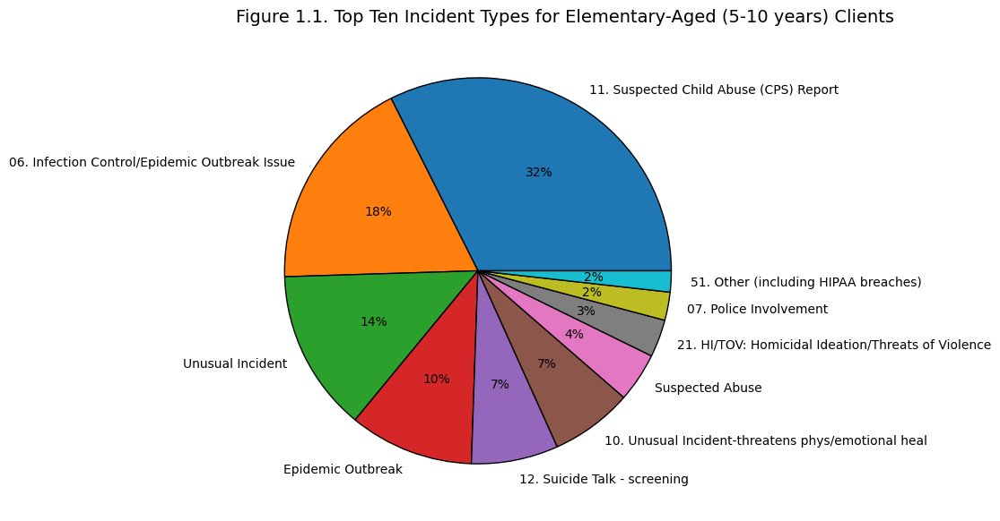

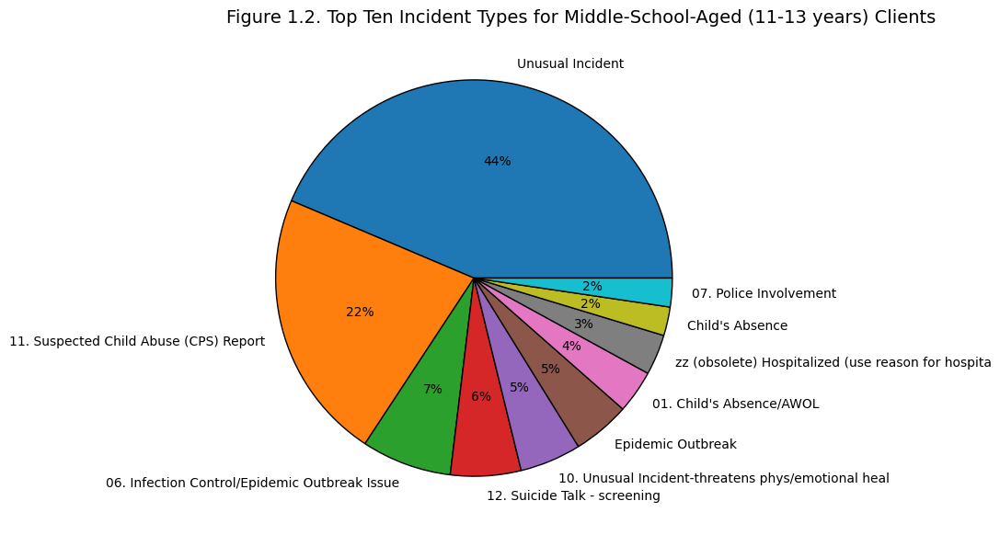

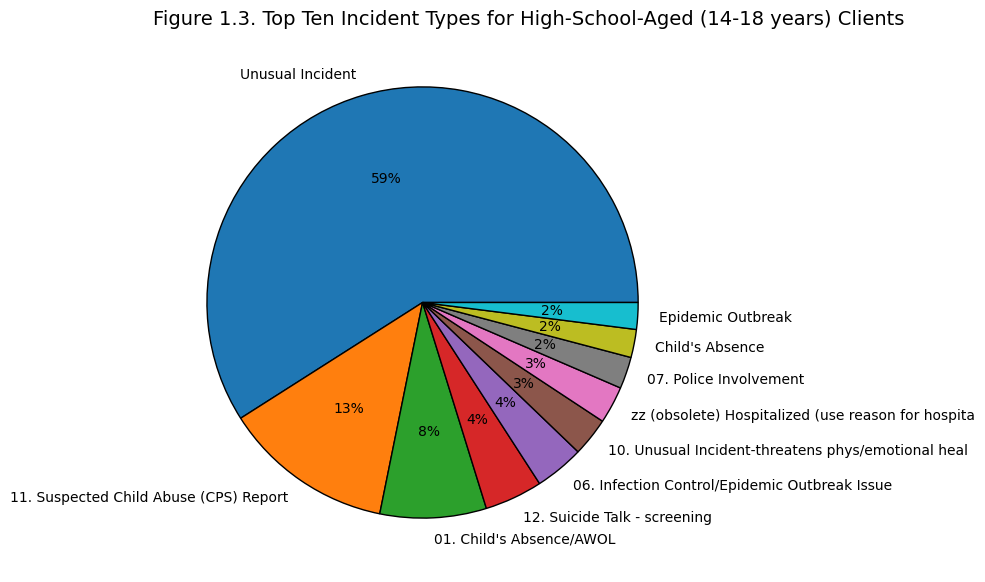

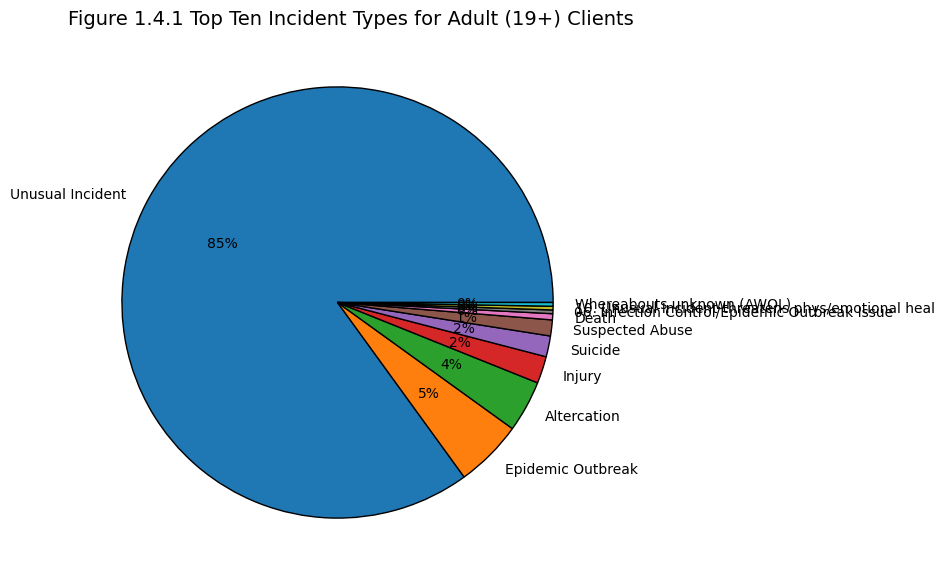

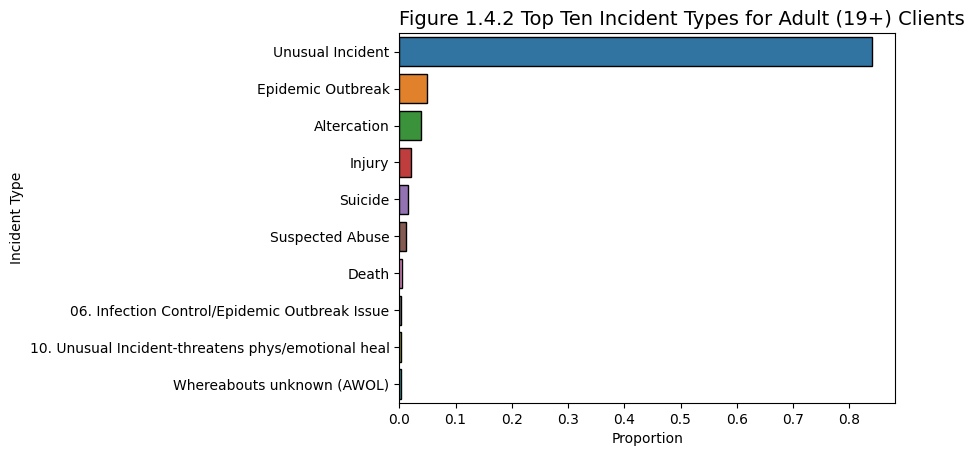

In [8]:
# Filter `incidents` and `demographics` dataframes
elementary_incidents = incidents.query('AgeAtIncident >= 5 and AgeAtIncident <= 10')
elementary_pop = demographics.query('AgeAtStart >= 5 and AgeAtStart <= 10')
middle_incidents = incidents.query('AgeAtIncident > 10 and AgeAtIncident <= 13')
middle_pop = demographics.query('AgeAtStart > 10 and AgeAtStart <= 13')
high_incidents = incidents.query('AgeAtIncident > 13 and AgeAtIncident <= 18')
high_pop = demographics.query('AgeAtStart > 13 and AgeAtStart <= 18')
adult_incidents = incidents.query('AgeAtIncident > 18')
adult_pop = demographics.query('AgeAtStart > 18')

filtered_incidents = [elementary_incidents, middle_incidents,
                      high_incidents, adult_incidents]

# Filtered incidents dataframes with top ten counts
elementary_top_ten, middle_top_ten, high_top_ten, adult_top_ten = [incidents_df.groupby('IncidentType').count() \
                                                                               .reset_index()[['IncidentType', 'IncidentDate']] \
                                                                               .rename(columns={'IncidentDate':'Count'}) \
                                                                               .sort_values('Count', ascending=False) \
                                                                               .head(10) for incidents_df in filtered_incidents]

# Calculate proportions
elementary_prop = elementary_incidents.shape[0] / incidents.shape[0]
elem_pop_prop = elementary_pop.shape[0] / demographics.shape[0]
middle_prop = middle_incidents.shape[0] / incidents.shape[0]
middle_pop_prop = middle_pop.shape[0] / demographics.shape[0]
high_prop = high_incidents.shape[0] / incidents.shape[0]
high_pop_prop = high_pop.shape[0] / demographics.shape[0]
adult_prop = adult_incidents.shape[0] / incidents.shape[0]
adult_pop_prop = adult_pop.shape[0] / demographics.shape[0]

# Display proportions
print(f'Proportion of Elementary-Age Incidents: {elementary_prop} \t|\t Proportion of Client Population: {elem_pop_prop}')
print(f'Proportion of Middle-School-Age Incidents: {middle_prop} \t|\t Proportion of Client Population: {middle_pop_prop}')
print(f'Proportion of High-School-Age Incidents: {high_prop} \t|\t Proportion of Client Population: {high_pop_prop}')
print(f'Proportion of Adult Incidents: {adult_prop} \t\t|\t Proportion of Client Population: {adult_pop_prop}')

# Plot bar plots of incident type counts
    # Elementary
plt.figure(figsize=(7, 7))
plt.pie(x=elementary_top_ten['Count'].values,
        labels=elementary_top_ten['IncidentType'].values,
        autopct='%.0f%%')
plt.title('Figure 1.1. Top Ten Incident Types for Elementary-Aged (5-10 years) Clients',
          loc='left',
          fontdict={'fontsize': 14})
plt.show()

    # Middle
plt.figure(figsize=(7, 7))
plt.pie(x=middle_top_ten['Count'].values,
        labels=middle_top_ten['IncidentType'].values,
        autopct='%.0f%%')
plt.title('Figure 1.2. Top Ten Incident Types for Middle-School-Aged (11-13 years) Clients',
          loc='left',
          fontdict={'fontsize': 14})
plt.show()

    # High
plt.figure(figsize=(7, 7))
plt.pie(x=high_top_ten['Count'].values,
        labels=high_top_ten['IncidentType'].values,
        autopct='%.0f%%')
plt.title('Figure 1.3. Top Ten Incident Types for High-School-Aged (14-18 years) Clients',
          loc='left',
          fontdict={'fontsize': 14})
plt.show()

    # Adult
plt.figure(figsize=(7, 7))
plt.pie(x=adult_top_ten['Count'].values,
        labels=adult_top_ten['IncidentType'].values,
        autopct='%.0f%%')
plt.title('Figure 1.4.1 Top Ten Incident Types for Adult (19+) Clients',
          loc='left',
          fontdict={'fontsize': 14})
plt.show()

sns.barplot(data=adult_top_ten, x=adult_top_ten['Count']/adult_incidents.shape[0], y='IncidentType')
plt.title('Figure 1.4.2 Top Ten Incident Types for Adult (19+) Clients',
          loc='left',
          fontdict={'fontsize': 14})
plt.xlabel('Proportion')
plt.ylabel('Incident Type')
plt.show()

### Seasonality Analysis

In [9]:
def convert_to_datetime(string):
    '''
    Function that takes a string in format MM/DD/YYYY and converts it to
    a Python datetime object
    -----
    Input:
    
    string (str) - String object to convert
    -----
    Output:
    
    time_obj (datetime) - datetime object
    '''
    format = '%m/%d/%Y'
    time_obj = datetime.strptime(string, format)
    return time_obj

def assign_season(month_num):
    '''
    Function that takes a month number (int) and converts it to a string
    denoting the season
    -----
    Input:
    
    month_num (int) - Int corresponding to month of the year
    -----
    Output:
    
    season (str) - String denoting the season corresponding to month_num
    '''
    if month_num in [12, 1, 2]:
        season = 'Winter'
    elif month_num in [3, 4, 5]:
        season = 'Spring'
    elif month_num in [6, 7, 8]:
        season = 'Summer'
    else:
        season = 'Fall'
    return season

def create_season_incident_df(incidents_df, season):
    '''
    Function that given a DataFrame with a list of incidents labelled by season
    returns a DataFrame with the top ten most common incidents in the specified
    season including the proportion of incidents in that season made up by each
    of those seasons
    -----
    Inputs:
    
    incidents_df (DataFrame) - DataFrame with a list of incidents labelled by season
    
    season (str) - String specifying the season to create
    -----
    Output:
    
    season_incident_counts (DataFrame) - DataFrame with the top ten incidents for
                                         the specified season and the proportion of
                                         that season's incidents made up of each
    '''
    season_incidents = incidents_df.query('Season == @season')
    season_incident_counts = season_incidents.groupby('IncidentType').count() \
                                             .sort_values('IncidentDate', ascending=False) \
                                             [['IncidentDate']] \
                                             .rename(columns={'IncidentDate': 'Count'}) \
                                             .reset_index()
    total_incidents = sum(season_incident_counts['Count'])
    season_incident_counts['Proportion'] = [count/total_incidents for count in season_incident_counts['Count']]
    return season_incident_counts.head(10)

In [10]:
incidents['IncidentDate'] = incidents['IncidentDate'].apply(convert_to_datetime)
incidents['IncidentMonth'] = [date_object.month for date_object in incidents['IncidentDate']]
incidents['IncidentYear'] = [date_object.year for date_object in incidents['IncidentDate']]
incidents = incidents.reindex(columns=['IncidentDate',
                                       'IncidentMonth',
                                       'IncidentYear',
                                       'IncidentTypeCode',
                                       'IncidentType',
                                       'SubTypeCode',
                                       'IncidentSubType',
                                       'OptionsNumber',
                                       'AgeAtIncident',
                                       'Gender',
                                       'Ethnicity',
                                       'PrimaryLanguage',
                                       'Religion',
                                       'ServiceDivision'])
incidents['Season'] = incidents['IncidentMonth'].apply(assign_season)
incidents

,IncidentDate,IncidentMonth,IncidentYear,IncidentTypeCode,IncidentType,SubTypeCode,IncidentSubType,OptionsNumber,AgeAtIncident,Gender,Ethnicity,PrimaryLanguage,Religion,ServiceDivision,Season
0,2019-12-30,12,2019,3,Child's Absence,NaN,NaN,72077,17,M,Hispanic/Latino,English,No Preference,Foster Care,Winter
1,2020-02-02,2,2020,3,Child's Absence,NaN,NaN,72077,17,M,Hispanic/Latino,English,No Preference,Foster Care,Winter
2,2020-02-21,2,2020,3,Child's Absence,NaN,NaN,72077,17,M,Hispanic/Latino,English,No Preference,Foster Care,Winter
3,2020-03-18,3,2020,3,Child's Absence,NaN,NaN,72077,17,M,Hispanic/Latino,English,No Preference,Foster Care,Spring
4,2020-02-22,2,2020,3,Child's Absence,NaN,NaN,72385,16,F,Black,English,No Preference,Foster Care,Winter
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6286,2022-08-29,8,2022,6,Epidemic Outbreak,NaN,NaN,90660,4,M,Hispanic/Latino,English,No Preference,Foster Care,Summer
6287,2022-08-29,8,2022,6,Epidemic Outbreak,NaN,NaN,90661,2,M,Hispanic/Latino,English,No Preference,Foster Care,Summer
6288,2022-08-27,8,2022,5,Injury,NaN,NaN,90661,2,M,Hispanic/Latino,English,No Preference,Foster Care,Summer
6289,2022-08-25,8,2022,22,zz. (obsolete) Crisis Center Visit (use reason...,NaN,NaN,64257,16,M,[Not Entered],English,[Not Entered],Behavioral Health,Summer


In [11]:
print('Winter')
display(create_season_incident_df(incidents, 'Winter'))
print('Spring')
display(create_season_incident_df(incidents, 'Spring'))
print('Summer')
display(create_season_incident_df(incidents, 'Summer'))
print('Fall')
display(create_season_incident_df(incidents, 'Fall'))

Winter


,IncidentType,Count,Proportion
0,Unusual Incident,780,0.469314
1,11. Suspected Child Abuse (CPS) Report,170,0.102286
2,06. Infection Control/Epidemic Outbreak Issue,141,0.084838
3,Epidemic Outbreak,133,0.080024
4,10. Unusual Incident-threatens phys/emotional ...,65,0.039110
5,12. Suicide Talk - screening,54,0.032491
6,01. Child's Absence/AWOL,51,0.030686
7,zz (obsolete) Hospitalized (use reason for hos...,45,0.027076
8,Child's Absence,34,0.020457
9,07. Police Involvement,30,0.018051


Spring


,IncidentType,Count,Proportion
0,Unusual Incident,767,0.515804
1,11. Suspected Child Abuse (CPS) Report,187,0.125757
2,01. Child's Absence/AWOL,79,0.053127
3,12. Suicide Talk - screening,58,0.039005
4,10. Unusual Incident-threatens phys/emotional ...,51,0.034297
5,Suspected Abuse,32,0.021520
6,Epidemic Outbreak,30,0.020175
7,zz (obsolete) Hospitalized (use reason for hos...,29,0.019502
8,07. Police Involvement,25,0.016812
9,zz. (obsolete) Crisis Center Visit (use reason...,23,0.015467


Summer


,IncidentType,Count,Proportion
0,Unusual Incident,844,0.505087
1,11. Suspected Child Abuse (CPS) Report,195,0.116697
2,01. Child's Absence/AWOL,94,0.056254
3,06. Infection Control/Epidemic Outbreak Issue,82,0.049072
4,Epidemic Outbreak,79,0.047277
5,12. Suicide Talk - screening,54,0.032316
6,07. Police Involvement,29,0.017355
7,Injury,28,0.016756
8,14. Suicide Talk resulting in Hospitalization,27,0.016158
9,10. Unusual Incident-threatens phys/emotional ...,26,0.015560


Fall


,IncidentType,Count,Proportion
0,Unusual Incident,827,0.562203
1,11. Suspected Child Abuse (CPS) Report,200,0.135962
2,12. Suicide Talk - screening,54,0.036710
3,01. Child's Absence/AWOL,51,0.034670
4,Epidemic Outbreak,38,0.025833
5,06. Infection Control/Epidemic Outbreak Issue,33,0.022434
6,10. Unusual Incident-threatens phys/emotional ...,28,0.019035
7,zz (obsolete) Hospitalized (use reason for hos...,27,0.018355
8,Altercation,24,0.016315
9,07. Police Involvement,19,0.012916


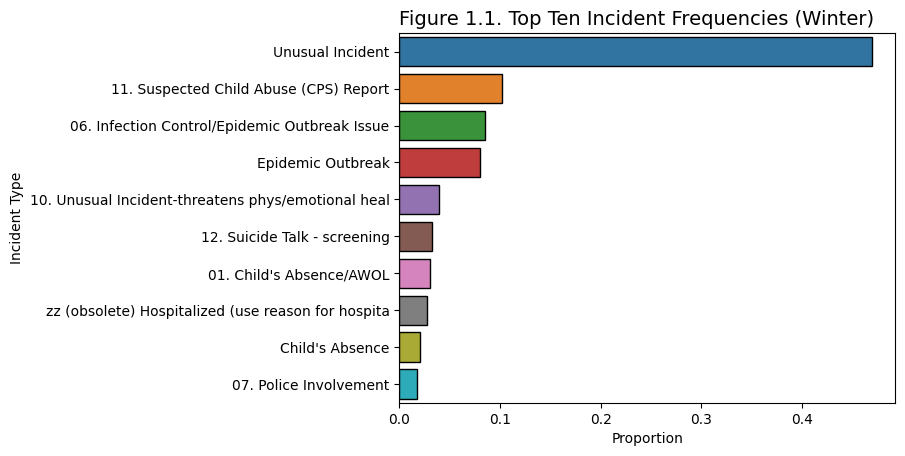

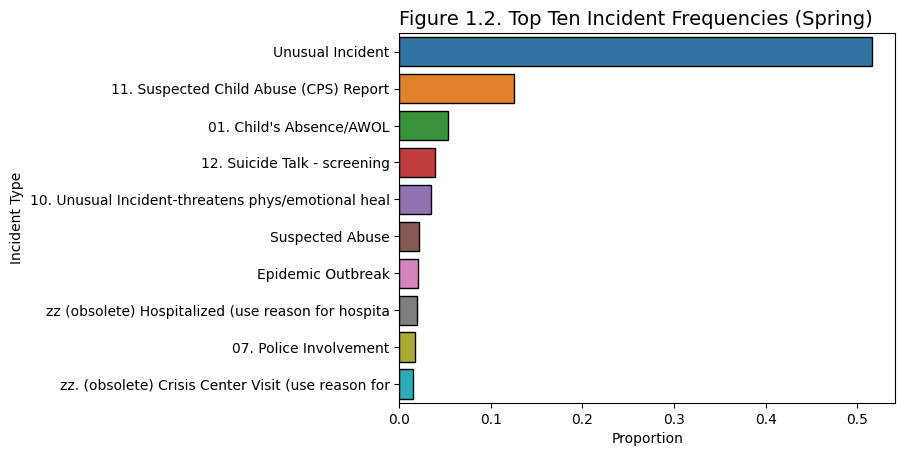

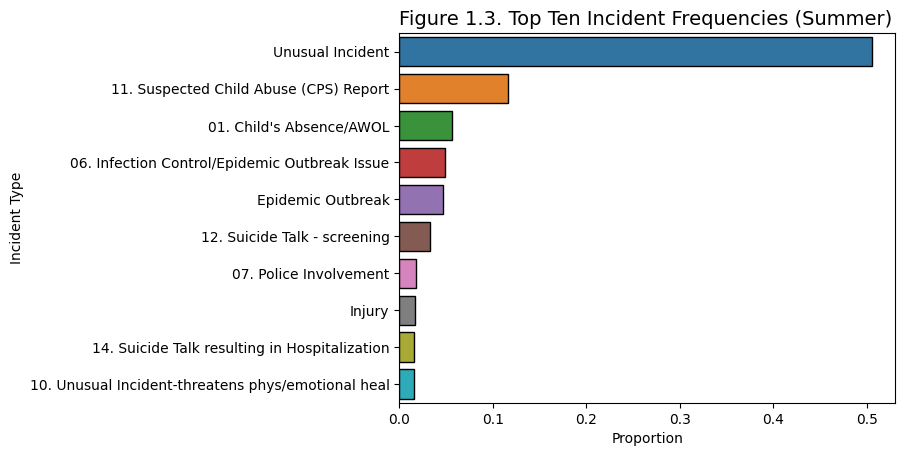

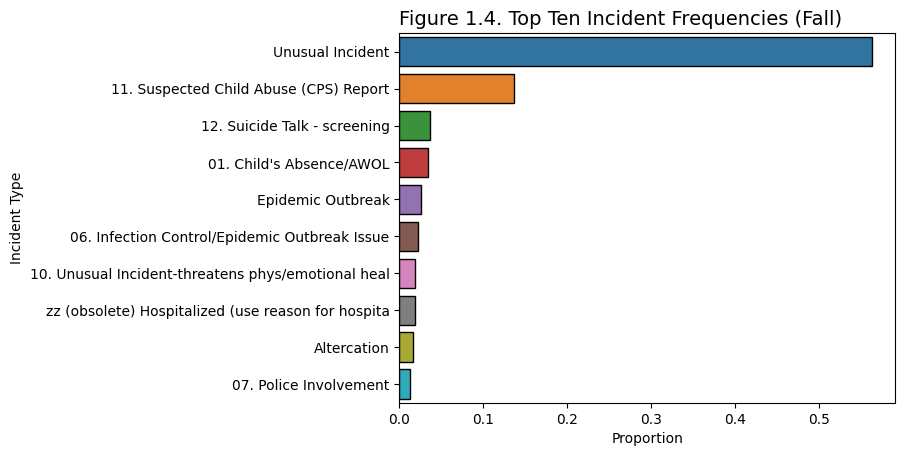

In [12]:
# Plot bar plots per season

# Figure 1.1. Top Ten Incident Frequencies (Winter)
fig1_1 = sns.barplot(data=create_season_incident_df(incidents, 'Winter'),
                     orient='h',
                     x='Proportion',
                     y='IncidentType')
plt.ylabel('Incident Type')
plt.title('Figure 1.1. Top Ten Incident Frequencies (Winter)',
          loc='left',
          fontdict={'fontsize': 14})
plt.show()

# Figure 1.2. Top Ten Incident Frequences (Spring)
fig1_2 = sns.barplot(data=create_season_incident_df(incidents, 'Spring'),
                     orient='h',
                     x='Proportion',
                     y='IncidentType')
plt.ylabel('Incident Type')
plt.title('Figure 1.2. Top Ten Incident Frequencies (Spring)',
          loc='left',
          fontdict={'fontsize': 14})
plt.show()

# Figure 1.3. Top Ten Incident Frequencies (Summer)
fig1_3 = sns.barplot(data=create_season_incident_df(incidents, 'Summer'),
                     orient='h',
                     x='Proportion',
                     y='IncidentType')
plt.ylabel('Incident Type')
plt.title('Figure 1.3. Top Ten Incident Frequencies (Summer)',
          loc='left',
          fontdict={'fontsize': 14})
plt.show()

# Figure 1.4. Top Ten Incident Frequencies (Fall)
fig1_4 = sns.barplot(data=create_season_incident_df(incidents, 'Fall'),
                     orient='h',
                     x='Proportion',
                     y='IncidentType')
plt.ylabel('Incident Type')
plt.title('Figure 1.4. Top Ten Incident Frequencies (Fall)',
          loc='left',
          fontdict={'fontsize': 14})
plt.show()

In [13]:
fall_incidents = incidents.query('Season == "Fall"')
fall_incident_counts = fall_incidents.groupby('IncidentType').count().sort_values('IncidentDate', ascending=False)[['IncidentDate']] \
                                     .rename(columns={'IncidentDate': 'Count'})
total_incidents = sum(fall_incident_counts['Count'])
fall_incident_counts['Proportion'] = [count/total_incidents for count in fall_incident_counts['Count']]
fall_incident_counts

,Count,Proportion
IncidentType,,
Unusual Incident,827,0.562203
11. Suspected Child Abuse (CPS) Report,200,0.135962
12. Suicide Talk - screening,54,0.036710
01. Child's Absence/AWOL,51,0.034670
Epidemic Outbreak,38,0.025833
06. Infection Control/Epidemic Outbreak Issue,33,0.022434
10. Unusual Incident-threatens phys/emotional heal,28,0.019035
zz (obsolete) Hospitalized (use reason for hospita,27,0.018355
Altercation,24,0.016315


In [14]:
incidents_sex_race = incidents.merge(demographics.iloc[:, :2], on='OptionsNumber') \
                              .drop(columns=['PrimaryLanguage', 
                                             'Religion',
                                             'ServiceDivision',
                                             'Season',
                                             'Gender_y']) \
                              .rename(columns={'Gender_x': 'Sex'})
incidents_sex_race

,IncidentDate,IncidentMonth,IncidentYear,IncidentTypeCode,IncidentType,SubTypeCode,IncidentSubType,OptionsNumber,AgeAtIncident,Sex,Ethnicity
0,2021-01-11,1,2021,6,Epidemic Outbreak,NaN,NaN,77036,12,F,White
1,2021-01-19,1,2021,6,Epidemic Outbreak,NaN,NaN,77036,12,F,White
2,2022-02-01,2,2022,6,Epidemic Outbreak,NaN,NaN,77036,13,F,White
3,2022-02-01,2,2022,6,Epidemic Outbreak,NaN,NaN,77037,14,F,White
4,2021-01-19,1,2021,6,Epidemic Outbreak,NaN,NaN,77037,13,F,White
...,...,...,...,...,...,...,...,...,...,...,...
2095,2022-10-07,10,2022,18,11. Suspected Child Abuse (CPS) Report,NaN,NaN,64477,15,F,Mexican
2096,2022-10-07,10,2022,18,11. Suspected Child Abuse (CPS) Report,NaN,NaN,64477,15,F,Mexican
2097,2022-09-01,9,2022,18,11. Suspected Child Abuse (CPS) Report,NaN,NaN,64518,13,M,White
2098,2022-10-19,10,2022,18,11. Suspected Child Abuse (CPS) Report,NaN,NaN,64532,16,M,Mexican


In [15]:
female_incidents_matrix = incidents_sex_race.query('Sex == "F"') \
                                            .groupby('IncidentType').count() \
                                            [['IncidentDate']] \
                                            .rename(columns={'IncidentDate': 'Count'}) \
                                            .sort_values('Count', ascending=False) \
                                            .reset_index() \
                                            .head(15)
female_incidents_total = sum(female_incidents_matrix['Count'])
female_incidents_matrix['Proportion'] = [count/female_incidents_total for count in female_incidents_matrix['Count']]
print('Female')
display(female_incidents_matrix)

male_incidents_matrix = incidents_sex_race.query('Sex == "M"') \
                                          .groupby('IncidentType').count() \
                                          [['IncidentDate']] \
                                          .rename(columns={'IncidentDate': 'Count'}) \
                                          .sort_values('Count', ascending=False) \
                                          .reset_index() \
                                          .head(25)
male_incidents_total = sum(male_incidents_matrix['Count'])
male_incidents_matrix['Proportion'] = [count/male_incidents_total for count in male_incidents_matrix['Count']]
print('Male')
display(male_incidents_matrix)

Female


,IncidentType,Count,Proportion
0,Unusual Incident,236,0.266366
1,11. Suspected Child Abuse (CPS) Report,177,0.199774
2,01. Child's Absence/AWOL,105,0.118510
3,06. Infection Control/Epidemic Outbreak Issue,97,0.109481
4,Epidemic Outbreak,80,0.090293
5,12. Suicide Talk - screening,38,0.042889
6,90. Placement Change: Same Level (Lateral),26,0.029345
7,14. Suicide Talk resulting in Hospitalization,26,0.029345
8,05. Hospitalized for Medical Reasons,16,0.018059
9,13. Suicide Talk resulting in outside interven...,15,0.016930


Male


,IncidentType,Count,Proportion
0,Unusual Incident,428,0.425871
1,11. Suspected Child Abuse (CPS) Report,141,0.140299
2,06. Infection Control/Epidemic Outbreak Issue,118,0.117413
3,Epidemic Outbreak,70,0.069652
4,07. Police Involvement,34,0.033831
5,12. Suicide Talk - screening,27,0.026866
6,10. Unusual Incident-threatens phys/emotional ...,22,0.021891
7,01. Child's Absence/AWOL,21,0.020896
8,zz (obsolete) Hospitalized (use reason for hos...,18,0.017910
9,21. HI/TOV: Homicidal Ideation/Threats of Viol...,16,0.015920


### Readmissions

In [16]:
readmits = demographics.groupby('OptionsNumber').count().sort_values('Gender', ascending=False) \
                       .query('Gender > 1').reset_index()['OptionsNumber'].values

In [17]:
bool_arr_incidents = [id_num in readmits for id_num in incidents['OptionsNumber'].values]
readmissions_first_incident = incidents[bool_arr_incidents].sort_values('IncidentDate') \
                                                           .drop_duplicates(subset='OptionsNumber')
bool_arr_demographics = [id_num in readmits for id_num in demographics['OptionsNumber'].values]
readmissions = demographics[bool_arr_demographics].sort_values('AgeAtStart') \
                                                  .drop_duplicates('OptionsNumber')
readmissions_joined = readmissions.merge(readmissions_first_incident, on='OptionsNumber',
                                        how='left')
readmissions_joined

non_bool_arr_incidents = [item == False for item in bool_arr_incidents]
nonreadmit_first_incident = incidents[non_bool_arr_incidents].sort_values('IncidentDate') \
                                                             .drop_duplicates(subset='OptionsNumber')
non_bool_arr_demographics = [item == False for item in bool_arr_demographics]
nonreadmissions = demographics[non_bool_arr_demographics]
nonreadmissions_joined = nonreadmissions.merge(nonreadmit_first_incident, on='OptionsNumber',
                                               how='left')

train = readmissions_joined.append(nonreadmissions_joined) \
                           .drop(labels=['IncidentDate', 'IncidentMonth', 'IncidentYear',
                                         'IncidentTypeCode', 'IncidentType','SubTypeCode',
                                         'IncidentSubType', 'Gender_y', 'Ethnicity_y',
                                         'PrimaryLanguage_y', 'ServiceDivision_y'], axis=1) \
                           .rename(columns={'Gender_x':'Gender', 'Ethnicity_x':'Race',
                                            'PrimaryLanguage_x':'PrimaryLanguage', 'Religion_x':'Religion',
                                            'ServiceDivision_x':'ServiceDivision'})
train['Incident'] = [0 if np.isnan(age) else 1 for age in train['AgeAtIncident'].values]

/var/folders/1r/4mzq17hx6fn9bwwgql3rjf9c0000gn/T/ipykernel_66465/448376220.py:19: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



In [18]:
['Gender'] + train.columns.tolist()[3:-3] + ['Season']

['Gender',
 'Race',
 'PrimaryLanguage',
 'Religion',
 'ServiceDivision',
 'CountyofService',
 'County',
 'AgeAtIncident',
 'Season']

In [19]:
# One Hot Encoding
from sklearn import preprocessing
reordered_train = train.query('Incident == 1')[['Gender'] + train.columns.tolist()[3:-3] + ['Season']]
enc = preprocessing.OneHotEncoder()
enc.fit(reordered_train)
one_hot_encoded_data = enc.transform(reordered_train).toarray()